In [1]:
# pip install opencv-python-headless numpy


In [2]:
import cv2
import numpy as np

# Load the image
image = cv2.imread('./WhatsApp Image 2023-11-29 at 12.20.25.jpeg')

# Convert the image to grayscale
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Convert the grayscale image to a NumPy array
gray_array = np.array(gray_image)

# Display the shape of the NumPy array
print(gray_array.shape)

# Optionally, save the grayscale image
cv2.imwrite('grayscale_image.jpg', gray_image)


(876, 1600)


True

In [3]:
max(gray_array[0])

223

In [4]:
# import cv2
# import numpy as np

# # Ask the user for the image file path
# image_path = input("Enter the path to the image file: ")

# try:
#     # Load the image
#     image = cv2.imread(image_path)

#     # Convert the image to grayscale
#     gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

#     # Convert the grayscale image to a NumPy array
#     gray_array = np.array(gray_image)

#     # Display the shape of the NumPy array
#     print("Shape of the grayscale array:", gray_array.shape)

#     # Optionally, save the grayscale image
#     cv2.imwrite('grayscale_image.jpg', gray_image)

# except Exception as e:
#     print("An error occurred:", e)


In [5]:
# import random

# def generate_random_pixels(width, height, pixel_range):
#     pixels = [[(random.randint(pixel_range[0], pixel_range[1]))
#                for _ in range(width)]
#               for _ in range(height)]
#     return pixels

# # Define parameters
# width = 800
# height = 600
# pixel_range = (0, 49)  # Example: for grayscale L=50

# Generate 2D array of pixels
array1 = gray_array
array = np.array(array1, dtype=np.int16)



In [6]:
shape = gray_array.shape
width = shape[1]
height = shape[0]
pixel_range = (0, 255)
d1 = 8 # horizontal
d2 = 8 # vertical
n=25 #vertical i
m=25 #horizontal j

In [7]:
arr1 = {i: 0 for i in range(2*pixel_range[1]+1)}
arr2 = {i: 0 for i in range(-pixel_range[1], pixel_range[1]+1)}
temp_sum = {i: 0 for i in range(2*pixel_range[1]+1)}
temp_diff = {i: 0 for i in range(-pixel_range[1], pixel_range[1]+1)}

In [8]:
import numpy as np

In [9]:
import math

def ASM(S,D):
    Psum=0
    Pdiff=0

    for i in range(0,len(S)):
        Psum += (S[i])**2

    for i in range(0,len(S)):
        Pdiff += (D[i])**2

    return Psum*Pdiff

def IDM(S,D):
    Sum=0
    L= (len(D)+1)/2
    for j in range(0,len(D)):
        Sum += D[j]/(1+(j-L+1)**2)

    return Sum

def CON(S,D):
    Sum=0
    L= (len(D)+1)/2
    for j in range(0,len(D)):
        Sum += ((j-L+1)**2)*D[j]

    return Sum

def ENT(S,D):
    SumS=0
    SumD=0

    for i in range(0,len(S)):
        if(S[i]!=0):
            SumS += S[i]*(math.log10(S[i]))
        if(D[i]!=0):
            SumD += D[i]*(math.log10(D[i]))

    return -SumS-SumD

In [10]:
asm = np.array([[0 for j in range(width-m)] for i in range(height-n)],dtype=float)
idm = np.array([[0 for j in range(width-m)] for i in range(height-n)],dtype=float)
con = np.array([[0 for j in range(width-m)] for i in range(height-n)],dtype=float)
ent = np.array([[0 for j in range(width-m)] for i in range(height-n)],dtype=float)

In [11]:
def norm(ar):
  sum = np.sum(ar)
  normalized_data = ar / sum
  return normalized_data


In [12]:
for k in range(height-n):
  for l in range(width-m):
    if(l==0):
      for i in range(n-d2):
        for j in range(m-d1):
          arr1[array[k+i][l+j]+array[k+i+d2][l+j+d1]] = arr1[array[k+i][l+j]+array[k+i+d2][l+j+d1]] + 1

          arr2[array[k+i][l+j]-array[k+i+d2][l+j+d1]] = arr2[array[k+i][l+j]-array[k+i+d2][l+j+d1]] + 1

          if(j==0):
            temp_sum[array[k+i][l+j]+array[k+i+d2][l+j+d1]] = temp_sum[array[k+i][l+j]+array[k+i+d2][l+j+d1]] + 1
            temp_diff[array[k+i][l+j]-array[k+i+d2][l+j+d1]] = temp_diff[array[k+i][l+j]-array[k+i+d2][l+j+d1]] + 1

      S = np.zeros(len(list(arr1.values()))) if np.sum(list(arr1.values())) == 0 else norm(np.array(list(arr1.values())))
      D = np.zeros(len(list(arr2.values()))) if np.sum(list(arr2.values())) == 0 else norm(np.array(list(arr2.values())))
      print(np.array(list(arr1.values())), S, np.array(list(arr2.values())), D)
      asm[k][l]=float(ASM(S,D))
      idm[k][l]=float(IDM(S,D))
      con[k][l]=float(CON(S,D))
      ent[k][l]=float(ENT(S,D))

    else:
      arr1 = {key: arr1[key] - temp_sum[key] for key in arr1 if key in temp_sum}
      arr2 = {key: arr2[key] - temp_diff[key] for key in arr2 if key in temp_diff}
      temp_sum = {key: 0 for key in temp_sum}
      temp_diff = {key: 0 for key in temp_diff}
      for i in range(n-d2):
        temp_sum[array[k+i][l+m-d1-1]+array[k+i+d2][l+m-1]] = temp_sum[array[k+i][l+m-d1-1]+array[k+i+d2][l+m-1]] + 1
        temp_diff[array[k+i][l+m-d1-1]-array[k+i+d2][l+m-1]] = temp_diff[array[k+i][l+m-d1-1]-array[k+i+d2][l+m-1]] + 1
      arr1 = {key: arr1[key] + temp_sum[key] for key in arr1 if key in temp_sum}
      arr2 = {key: arr2[key] + temp_diff[key] for key in arr2 if key in temp_diff}
      S = np.zeros(len(list(arr1.values()))) if np.sum(list(arr1.values())) == 0 else norm(np.array(list(arr1.values())))
      D = np.zeros(len(list(arr2.values()))) if np.sum(list(arr2.values())) == 0 else norm(np.array(list(arr2.values())))
      asm[k][l]=float(ASM(S,D))
      idm[k][l]=float(IDM(S,D))
      con[k][l]=float(CON(S,D))
      ent[k][l]=float(ENT(S,D))

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  1  0  1  0  0  2  3  2  1  0  2  2  2  3  0  0  2  1  2  1  0  5  3  3
  3  1  3  1  3  2  0  3  3  3  3  1  1  0  1  1  1  2  2  2  1  3  3  1
  2  1  0  1  0  2  0  1  1  1  2  0  0  0  0  0  1  0  0  1  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  1  0  0  0  0  0

In [13]:
asm

array([[0.00034578, 0.00040631, 0.00040586, ..., 0.00036112, 0.00036318,
        0.00037782],
       [0.00039609, 0.00045516, 0.00045937, ..., 0.00042772, 0.00043057,
        0.00043788],
       [0.00046814, 0.00051966, 0.00052059, ..., 0.00049458, 0.00049731,
        0.00050214],
       ...,
       [0.00020763, 0.00020766, 0.00020766, ..., 0.00020766, 0.00020767,
        0.00020767],
       [0.00020722, 0.00020725, 0.00020725, ..., 0.00020726, 0.00020726,
        0.00020726],
       [0.00020682, 0.00020684, 0.00020684, ..., 0.00020685, 0.00020685,
        0.00020685]])

In [14]:
idm

array([[0.07135169, 0.07588964, 0.08579492, ..., 0.07597694, 0.07693411,
        0.07980722],
       [0.07984258, 0.07922219, 0.08510719, ..., 0.0791191 , 0.07961218,
        0.08127048],
       [0.08400683, 0.08416992, 0.08815176, ..., 0.08347258, 0.08380466,
        0.08499206],
       ...,
       [0.12466938, 0.12467643, 0.12466818, ..., 0.12467257, 0.12467775,
        0.12467554],
       [0.12463455, 0.12464675, 0.12463539, ..., 0.12463941, 0.12464625,
        0.12463771],
       [0.12459754, 0.12461356, 0.12460477, ..., 0.12460624, 0.1246092 ,
        0.12460281]])

In [15]:
con

array([[13340.67820069, 13978.81314879, 13960.72318339, ...,
        14058.26297578, 13948.46020761, 13296.85467128],
       [13526.89619377, 14263.70766488, 14254.65597148, ...,
        14374.36541889, 14317.80035651, 13912.96256684],
       [14008.95764706, 14514.90516206, 14508.88355342, ...,
        14636.06482593, 14597.49819928, 14278.75390156],
       ...,
       [  849.54929815,   849.59880491,   849.59940679, ...,
          849.59671783,   849.59676546,   849.59915997],
       [  848.71678473,   848.76639261,   848.76683808, ...,
          848.76353815,   848.76418689,   848.76706298],
       [  847.885152  ,   847.93406166,   847.93386727, ...,
          847.93270955,   847.93245899,   847.93643326]])

In [16]:
ent

array([[3.7587046 , 3.69167282, 3.69091397, ..., 3.75443841, 3.7616827 ,
        3.72871368],
       [3.75677742, 3.68026811, 3.67718253, ..., 3.72381111, 3.72542869,
        3.7059018 ],
       [3.73089192, 3.66981929, 3.66670111, ..., 3.70501956, 3.70683976,
        3.69274551],
       ...,
       [3.9885327 , 3.98844201, 3.98845388, ..., 3.98850478, 3.98852291,
        3.98848256],
       [3.98908887, 3.98900637, 3.98901558, ..., 3.98906021, 3.98906969,
        3.9890389 ],
       [3.9896295 , 3.9895557 , 3.98956165, ..., 3.98960654, 3.98961622,
        3.98959893]])

In [17]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [18]:
data ={}
df = pd.DataFrame(data)


# Create a 2D NumPy array
array_2d = asm

# Flatten the array
flattened_array_asm = array_2d.ravel()

# Create a Pandas Series from the flattened array
asm_s = pd.Series(flattened_array_asm)
df['asm'] = asm_s


# Create a 2D NumPy array
array_2d = idm

# Flatten the array
flattened_array_idm = array_2d.ravel()

# Create a Pandas Series from the flattened array
idm_s = pd.Series(flattened_array_idm)
df['idm'] = idm_s


# Create a 2D NumPy array
array_2d = con

# Flatten the array
flattened_array_con = array_2d.ravel()

# Create a Pandas Series from the flattened array
con_s = pd.Series(flattened_array_con)
df['con'] = con_s

# Create a 2D NumPy array
array_2d = ent

# Flatten the array
flattened_array_ent = array_2d.ravel()

# Create a Pandas Series from the flattened array
ent_s = pd.Series(flattened_array_ent)
df['ent'] = ent_s









In [19]:
# df= pd.read_csv("/content/drive/MyDrive/GNR 607/wine-clustering.csv")
# df

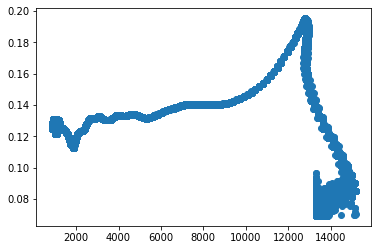

In [20]:
X = df.iloc[:,2]
y = df.iloc[:,1]
plt.scatter(X,y);

In [21]:
# # import module
# from sklearn.preprocessing import StandardScaler

# # compute required values
# scaler = StandardScaler()
# model = scaler.fit(df)
# scaled_data = model.transform(df)

# # print scaled data
# print(scaled_data)


In [22]:
# from sklearn.decomposition import PCA
# pca_2 = PCA(n_components=3)
# pca_2_result = pca_2.fit_transform(scaled_data)
# print('Explained variation per principal component: {}'.format(pca_2.explained_variance_ratio_))

# # >> Explained variation per principal component: [0.36198848 0.1920749 ]

# print('Cumulative variance explained by 2 principal components: {:.2%}'.format(np.sum(pca_2.explained_variance_ratio_)))


In [23]:
scaled_data = df

In [24]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=4,max_iter=1000)
kmeans.fit(scaled_data)

KMeans(max_iter=1000, n_clusters=4)

In [25]:
cl = kmeans.predict(scaled_data)
cl.shape

(1340325,)

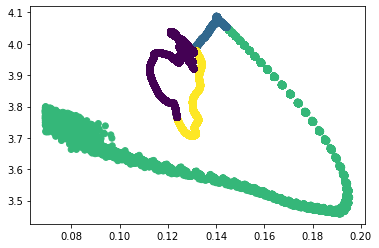

In [26]:
X = df.iloc[:,1]
y = df.iloc[:,-1]
plt.scatter(X,y,c=cl);

In [27]:
kmeans.inertia_

529071185186.0198

In [28]:
# from sklearn.model_selection import ParameterGrid
# import sklearn.metrics as metrics

# # candidate values for our number of cluster
# parameters = [2, 3, 4, 5, 10, 15, 20, 25, 30, 35, 40]
# # instantiating ParameterGrid, pass number of clusters as input
# parameter_grid = ParameterGrid({'n_clusters': parameters})
# best_score = -1
# kmeans_model = KMeans()     # instantiating KMeans model
# silhouette_scores = []
# # evaluation based on silhouette_score
# for p in parameter_grid:
#     kmeans_model.set_params(**p)    # set current hyper parameter
#     kmeans_model.fit(df)          # fit model on wine dataset, this will find clusters based on parameter p
#     ss = metrics.silhouette_score(df, kmeans_model.labels_)   # calculate silhouette_score
#     silhouette_scores += [ss]       # store all the scores
#     print('Parameter:', p, 'Score', ss)
#     # check p which has the best score
#     if ss > best_score:
#         best_score = ss
#         best_grid = p
# # plotting silhouette score
# plt.bar(range(len(silhouette_scores)), list(silhouette_scores), align='center', color='#722f59', width=0.5)
# plt.xticks(range(len(silhouette_scores)), list(parameters))
# plt.title('Silhouette Score', fontweight='bold')
# plt.xlabel('Number of Clusters')
# plt.show()


In [29]:
# fitting KMeans
kmeans = KMeans(n_clusters=4)
kmeans.fit(scaled_data)

final_cl = kmeans.predict(scaled_data)

In [30]:
# # def min_arr(arr):
# #   min = 255
# #   for i in arr:
# #    if min>i:
# #     min = i
# #   return min

def max_arr(arr):
    max = 0
    for i in range(0,arr.size):
      if max<arr[i]:
       max = arr[i]
    return max

In [31]:
# # max_v = max_arr(cl)# cl = scale_to_0_255(cl
# # final_cl = final_cl*255
max_v = max_arr(final_cl)
final_cl = final_cl*(255/max_v)

In [32]:
final_cl.shape

(1340325,)

In [33]:
final_cl = final_cl.reshape(ent.shape[0],ent.shape[1])
final_cl.shape

(851, 1575)

In [34]:
final_cl

array([[ 85.,  85.,  85., ...,  85.,  85.,  85.],
       [ 85.,  85.,  85., ...,  85.,  85.,  85.],
       [ 85.,  85.,  85., ...,  85.,  85.,  85.],
       ...,
       [170., 170., 170., ..., 170., 170., 170.],
       [170., 170., 170., ..., 170., 170., 170.],
       [170., 170., 170., ..., 170., 170., 170.]])

In [35]:
# import numpy as np

# def scale_to_0_255(arr):
#     min_value = min_arr(arr)
#     max_value = max_arr(arr)

#     scaled_arr = []

#     for value in arr:
#         scaled_value = ((value - min_value) / (max_value - min_value)) * 255
#         scaled_arr.append(scaled_value)

#     return scaled_arr


In [36]:
final_cl

array([[ 85.,  85.,  85., ...,  85.,  85.,  85.],
       [ 85.,  85.,  85., ...,  85.,  85.,  85.],
       [ 85.,  85.,  85., ...,  85.,  85.,  85.],
       ...,
       [170., 170., 170., ..., 170., 170., 170.],
       [170., 170., 170., ..., 170., 170., 170.],
       [170., 170., 170., ..., 170., 170., 170.]])

In [37]:
count = 0
for i in final_cl:
  for j in i:
    count+=j

count = count/255
count

746025.0

In [38]:
df_new = pd.DataFrame(final_cl)
df_new.to_csv('sample_data.csv', index=True)


In [39]:
# image = cv2.cvtColor(cl)  # Convert grayscale to BGR (color) image

# # Save the image to a file (optional)
# cv2.imwrite('output.png', image)

grayscale_image = cv2.merge((final_cl,final_cl,final_cl))


# Save the grayscale image to a file (optional)
cv2.imwrite('output4.png', grayscale_image)
# cv2.imshow(grayscale_image)


True